In [ ]:
# Reload-auto without kernel restart
%load_ext autoreload
%autoreload 2

# Utilities and System
import os
from dotenv import load_dotenv
from pathlib import Path
import sys
from datetime import datetime
from itertools import combinations


# Load environment variables
load_dotenv()

# Add parent directory to the sys path for module imports
sys.path.append("..")

# Data Manipulation and Analysis
import polars as pl
import numpy as np
import pandas as pd
from src.support.data_transformation import TickerExtender
from src.support.utils import load_config

# Statistical and Mathematical Operations
from scipy.signal import correlate, correlation_lags

# Plotting and Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from src.support.data_visualization import plot_acf_pacf, subplots_timeseries_lags

# OHLCV data from tickers and macroindicators
import yfinance as yf

# Typing
from typing import Tuple

- Análisis de correlaciones
- Cross-correlations? Para encontrar lags
- Mutual informations
- Establecer hipótesis de análisis y principios/conceptos básicos económicos que deben guiarme
- Identificar nuevos símbolos (por ejemplo USD/EUR) y dar conclusiones sobre su impacto

- Análisis entre stocks, stocks con macroindicadores. Luego 2º análisis de generación de indicadores técnicos en transformación.

Anotaciones:
- Existen similitudes en stocks del mismo sector aunque sean de otros continentes.
- Existen diferencias en las distribuciones de los growth rates entre stocks. Tampoco son del todo parecidas las distribuciones entre periodos para todos los stocks.
- Las series temporales tienen más tendencia a más grande el pct_change. Esto hace que tengan menos similitud de distribución.
- VIX es solo para US, cuidado con sus conclusiones

# Import data

In [7]:
dataset = pl.read_parquet("/home/miguel/data_science/algorithmic_trading/data/transformed/dataset.parquet")

In [8]:
filepaths = [file for file in Path("/home/miguel/data_science/algorithmic_trading/data/transformed/OHLCV").rglob('*') if file.is_file()]

first_symbol_name = str(filepaths[0]).split("/")[-1].replace(".csv","")
joined_symbol = pl.read_csv(filepaths[0]).select(pl.col("close","datetime")).rename({"close":first_symbol_name})

for file_path in filepaths[1:2]:
    symbol_name = str(file_path).split("/")[-1].replace(".csv","")
    symbol = pl.read_csv(file_path).select(pl.col("close","datetime")).rename({"close":symbol_name})
    joined_symbol = joined_symbol.join(symbol, on="datetime", how="inner")

joined_symbol = joined_symbol.fill_null(0)

## Plot example time series lags

In [9]:
stocks_tickers_list = load_config("tickers_to_include.yaml")["STOCKS"]

close_prices_df = pl.from_pandas(yf.download(tickers=stocks_tickers_list, 
                                             start="1998-01-01", 
                                             period="max", 
                                             interval="1d")["Close"], include_index=True).rename({"Date":"datetime"})

[*********************100%***********************]  33 of 33 completed


In [10]:
close_prices_df.select(pl.col("datetime"))

datetime
datetime[ns]
1998-01-01 00:00:00
1998-01-02 00:00:00
1998-01-05 00:00:00
1998-01-06 00:00:00
1998-01-07 00:00:00
…
2025-01-21 00:00:00
2025-01-22 00:00:00
2025-01-23 00:00:00


Let's plot the original time series and its lagged version for a few example stocks:

In [11]:
selected_examples = ["SAP","NVDA","NVO"]

for ticker in selected_examples:
    example_df = close_prices_df["datetime",ticker].drop_nulls()
    subplots_timeseries_lags(example_df, ticker_column=ticker)

In the time series for SAP, NVDA and NVO, we see that the shape of the original time series shows a growing trend in all tickers. Growth seems to accelerate from 2020 looking at the original timeseries in the first subplot. However, daily volatility has decreased for these stocks with regards to the beginning of the century, judging from the daily, 3d and 7d growth rates, where we see more pronounced fluctuations in periods around the crisis of 2002 and 2008. 

Yearly growth rates speak about the major cycles these stocks go through. In the case of NVO for example, the downfall dates concur with periods of economical crisis around 2008.


The shape of the distrivution for growth values seem in general quite similar throughout the years, saving for some periods of maximum fluctuations for some stocks like the beginning of the century. The bigger the lag analysed, the more trends are observed and thus the least similar the distributions. Taking a look at the different distributions for the examples above:

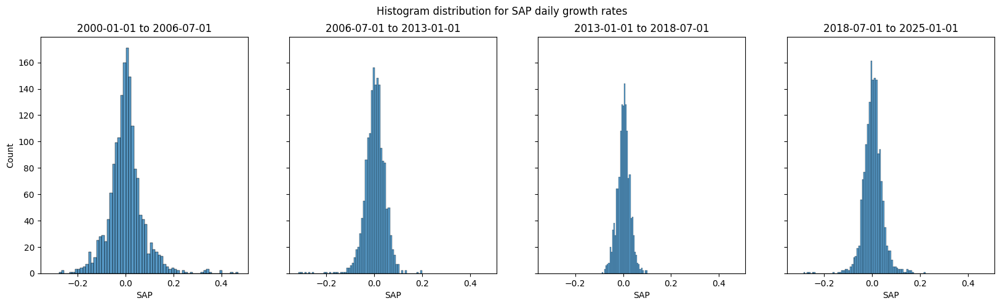

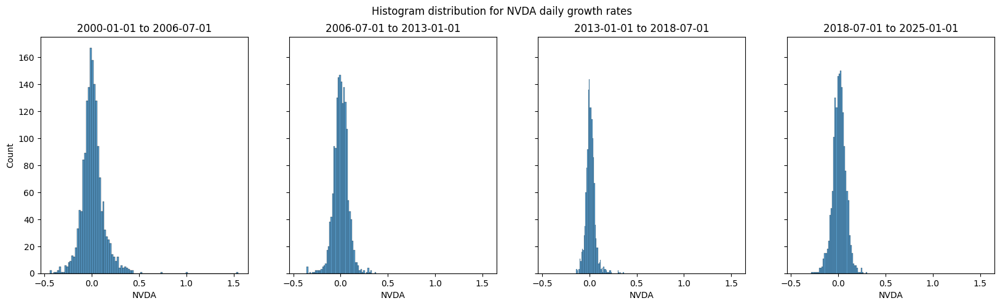

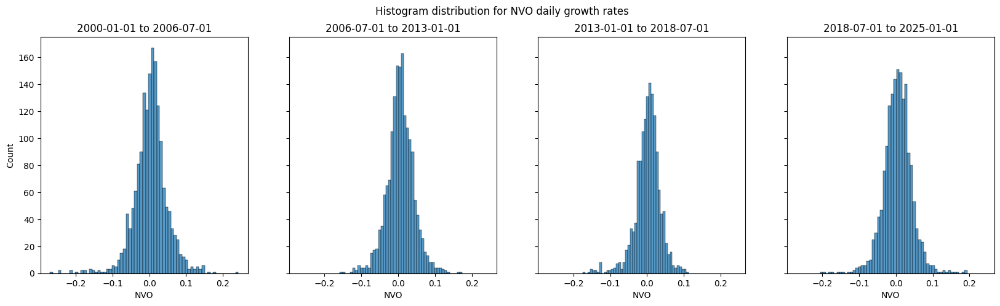

In [12]:
selected_examples = ["SAP","NVDA","NVO"]

for ticker in selected_examples:
    example_df_365d_lag = close_prices_df["datetime",ticker].with_columns(pl.col(ticker).pct_change(5)).drop_nulls()
    interval_edges = ["2000-01-01","2006-07-01","2013-01-01","2018-07-01","2025-01-01"]

    fig, axes = plt.subplots(1,4,figsize=(20,5), sharex=True,sharey=True)
    fig.suptitle(f"Histogram distribution for {ticker} daily growth rates")
    axes = axes.flat 
    for lapse, ax in enumerate(axes):
        start, end = [datetime.strptime(interval_edges[lapse], "%Y-%m-%d"), datetime.strptime(interval_edges[lapse+1], "%Y-%m-%d")]
        fig
        sns.histplot(data=example_df_365d_lag.filter(pl.col("datetime") > start, pl.col("datetime") < end),
                     x=ticker, ax=ax)
        ax.set_title(f"{interval_edges[lapse]} to {interval_edges[lapse+1]}")
    plt.show()

Looking at the growth rates, the differences seen between price distributions are cancelled, showing growth rates centered around 0 and tipically spread between -0.2 and 0.2.
This makes forecasting through classic methods more approachable as distributions among periods are similar. In these examples, the periods of maximum growth value spread is between 2000 and 2006, which seems to concur with world economic crisis taken place around that time.

Seeing these patterns, it is interesting to see how major macroeconomic indicators like the DGS and euroyield, and major indices like SNP500 in the US and EURONEXT in EU have evolved during these periods. Also looking at industry specific indices could be interesting.

## Macroeconomics - fear, greed and volatility

Me da la impresión de que la conclusión es: Hay correlaciones, parece que hay ciclos entre volatilidad, GOLD, stocks, DGS, etc, pero quien empieza el movimiento parece cambiar.
Mañana llegar rápido a esa conclusión y pasar a hacer forecasts. Ya volveremos a afinar esto después de los grafos. Hacer forecasts como tengo apuntado de varias maneras, tratar de hacerlo probabilistico y hacer hyperparameter tuning. Usar si puedo más adelante una función de optimización basada en el beneficio de los trades con una estrategia dada.
Relacionar:
- [X] GOLD, VIX y DGS 
- [ ] EuroYield (sumar a lo mejor el VSTOXX)
    - Comentar que el VIX vale para el resto de países.
- Comparar con SNP500 y otros europeos.
    - Hacer foco en stocks más estables vs otros menos estables pero de crecimiento para ver cómo reaccionan. 
    - También por sectores comparando con indices sectoriales.

    - De aquí sacar la teoría para integrar información sobre el radar plot de los tipos de stocks; crecimiento, valor, etc(tal vez calcular de info del SEC).
    - Añadir info sobre opinion de analistas en cuanto al fair value o calcularlo yo. (Aparte del news sentiment.)
- Hacer análisis de correlación y leadlag.
- Razonar si conviene usar lags o moving averages.
- Preguntar a ChatGPT cómo reaccionan los FEDFUNDS, el petróleo (mirar primero el chat anterior) y el GDPPOT (habría que encontrar algún equivalente europeo).
- Como se relaciona el CPI
- Cómo se relaciona el BTC
- Ver si meter algo asiático (en chat hay cosas). Si no me conviene embarrarme, meter en un backlog o next steps.

Al final guardar esto en una copia fantasma de este notebook que servirá de índice.


In [13]:
dgs_1 = pl.read_csv("../data/extracted/macro/DGS1.csv").rename({"date":"datetime"}).with_columns(pl.col("datetime").str.to_datetime())\
                                                        .with_columns(pl.col("dgs1").pct_change(1).alias("dgs1_growth1"))\
                                                        .with_columns(pl.col("dgs1").pct_change(22).alias("dgs1_growth30"))
vix = pl.read_csv("../data/extracted/macro/^VIX.csv").rename({"date":"datetime"})\
                                                    .select(pl.col("datetime").str.to_datetime(), "close").rename({"close":"VIX_close"})\
                                                    .with_columns(pl.col("VIX_close").pct_change(1).alias("VIX_close_growth1"))\
                                                    .with_columns(pl.col("VIX_close").pct_change(22).alias("VIX_close_growth30"))
                                                    

snp500 = pl.read_csv("../data/extracted/macro/^GSPC.csv").rename({"date":"datetime", "close":"SNP500_close","volume":"SNP500_volume"})\
                                                        .select(pl.col("datetime").str.to_datetime(), "SNP500_close","SNP500_volume")\
                                                        .with_columns(pl.col("SNP500_close").pct_change(1).alias("SNP500_close_growth1"))\
                                                        .with_columns(pl.col("SNP500_close").pct_change(22).alias("SNP500_close_growth30"))

gold = pl.read_csv("../data/extracted/macro/GC=F.csv").rename({"date":"datetime", "close":"GOLD_close", "volume":"GOLD_volume"})\
                                                        .select(pl.col("datetime").str.to_datetime(), "GOLD_close","GOLD_volume")\
                                                        .with_columns(pl.col("GOLD_close").pct_change(1).alias("GOLD_close_growth1"))\
                                                        .with_columns(pl.col("GOLD_close").pct_change(22).alias("GOLD_close_growth30"))


btc = pl.read_csv("../data/extracted/macro/BTC-USD.csv").rename({"date":"datetime", "close":"BTC_close", "volume":"BTC_volume"})\
                                                        .select(pl.col("datetime").str.to_datetime(), "BTC_close","BTC_volume")\
                                                        .with_columns(pl.col("BTC_close").pct_change(1).alias("BTC_close_growth1"))\
                                                        .with_columns(pl.col("BTC_close").pct_change(22).alias("BTC_close_growth30"))

macro_joined = dgs_1.join(vix, on="datetime", how="inner")\
                .join(snp500, on="datetime", how="inner") \
                .filter(pl.col("datetime") > datetime(1990, 1, 1)).fill_null(strategy="forward").drop_nulls()
macro_joined

datetime,dgs1,dgs1_growth1,dgs1_growth30,VIX_close,VIX_close_growth1,VIX_close_growth30,SNP500_close,SNP500_volume,SNP500_close_growth1,SNP500_close_growth30
datetime[μs],f64,f64,f64,f64,f64,f64,f64,i64,f64,f64
1990-02-01 00:00:00,8.09,0.001238,0.035851,24.870001,-0.019322,0.442575,328.790009,154580000,-0.000881,-0.085907
1990-02-02 00:00:00,8.13,0.004944,0.035669,24.32,-0.022115,0.336998,330.920013,164400000,0.006478,-0.077601
1990-02-05 00:00:00,8.15,0.00246,0.042199,24.540001,0.009046,0.276795,331.850006,130950000,0.00281,-0.066972
1990-02-06 00:00:00,8.15,0.0,0.046213,24.690001,0.006112,0.227747,329.660004,134070000,-0.006599,-0.063998
1990-02-07 00:00:00,8.17,0.002454,0.046095,24.290001,-0.016201,0.198914,333.75,186710000,0.012407,-0.056644
…,…,…,…,…,…,…,…,…,…,…
2025-01-16 00:00:00,4.18,-0.002387,-0.016471,16.6,0.029777,0.192529,5937.339844,4285810000,-0.002113,-0.018824
2025-01-17 00:00:00,4.21,0.007177,-0.02093,15.97,-0.037952,0.156408,5996.660156,4366830000,0.009991,-0.008995
2025-01-21 00:00:00,4.21,0.0,-0.014052,15.06,-0.056982,0.025187,6049.240234,4702920000,0.008768,-0.004089


In [14]:
fig = make_subplots(
    rows=3, 
    cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.02, 
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{}]]  # Define una lista con dos filas
)


fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["VIX_close"], name='VIX Volatility'), row=1, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["dgs1"], name='Deposit Guarantee Schemes - 1 Year'), row=1, col=1, secondary_y=True)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["SNP500_close"], name='SNP500'), row=2, col=1, secondary_y=False)
fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["SNP500_close_growth1"], name='SNP500_close_growth1'), row=2, col=1, secondary_y=True)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["SNP500_volume"], name='SNP500 volume'), row=3, col=1, secondary_y=False) # Bars do not color properly



# Add a date filter selector
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
        type="date"
    )
)

# Update layout for better visualization
fig.update_layout(height=900, title_text=f"close Time Series with Lags", showlegend=True)

# Show the figure
fig.show()

Observing the plot it might seem that there is a negative correlation between the VIX volatility index and the Deposit Guarantee Schemes for 1 Year period. We can see that interests/returns for the DGS1 tend to be high when the volatility is low. For example, from 2005 to 2008, DGS interests are somewhat high. However, nearing the 2008 crisis, returns plummet and shortly after the VIX spikes. After that, a long recovery period follows, where both interests are low and volatility remains lower, while investors return little by little to the stocks market. 

However, other things might interplay, as both the stock market and bonds can thrive if more common public investors enter the game.

Let's measure the correlation between VIX, SNP500 and DGS, and their growth features:

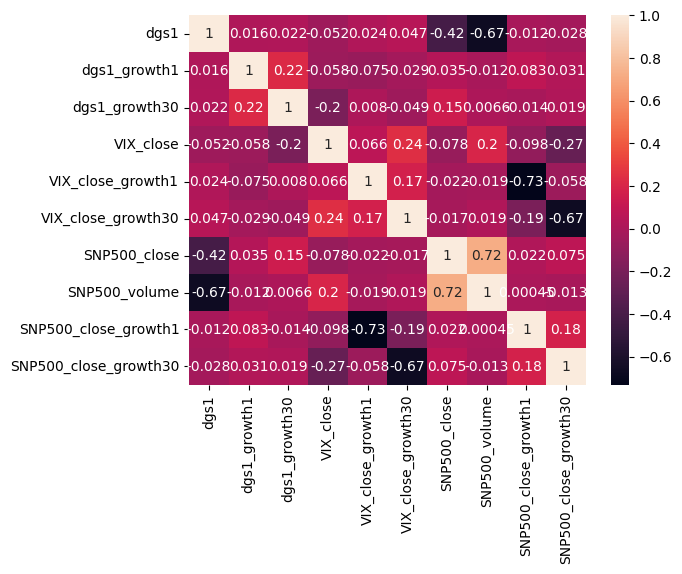

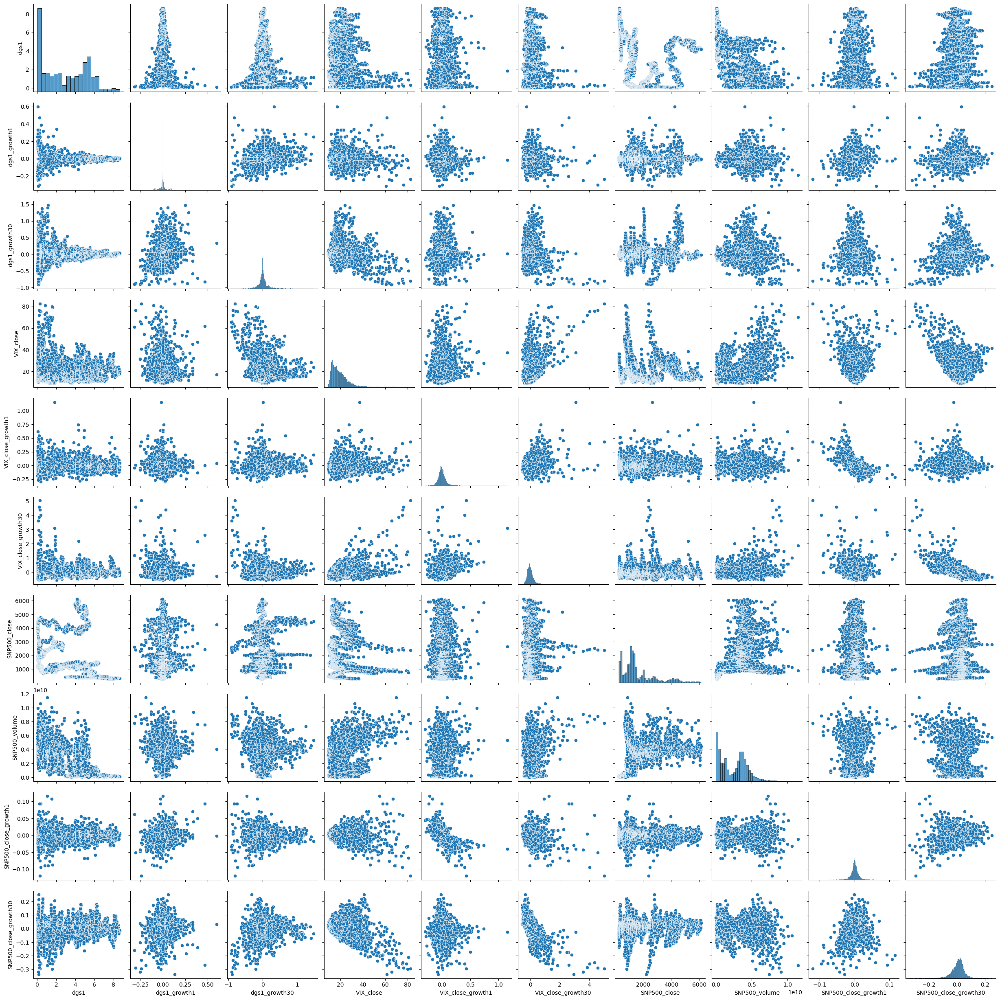

In [15]:
sns.heatmap(macro_joined.to_pandas().corr(numeric_only=True, method='spearman'), annot=True);

sns.pairplot(data=macro_joined.to_pandas());

From the plots above we can see that:
- There exists a very weak positive correlation between DGS1 and SNP500. However, there is a pattern that might or not be spurious, but more surely indicates less volatility and VIX when its values are low, indicating less activity. It is interesting to add this indicator to the model, adding in other factors that might interplay to create a bigger effect.
- VIX on the other hand shows a clearer correlation in both growth_1d and growth_30d rates.

Inspecting their rolling correlation:

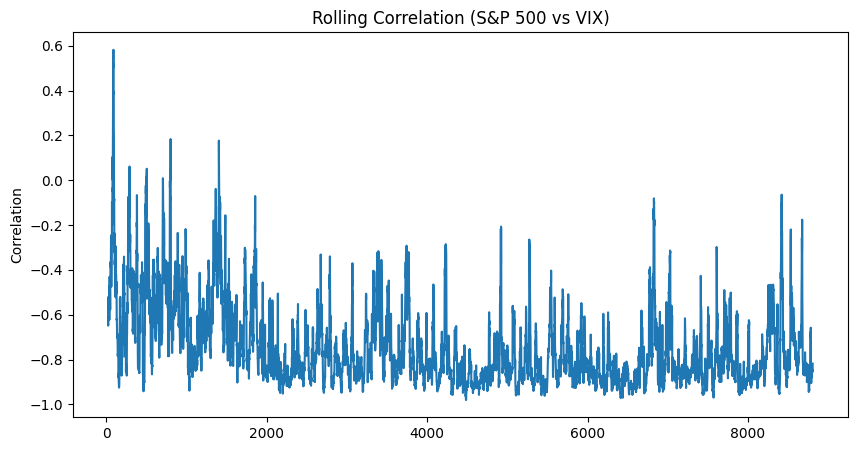

In [16]:
# Calculate rolling correlation
window = 22  # Rolling window size in time steps
rolling_corr = macro_joined['SNP500_close_growth1'].to_pandas().rolling(window).corr(macro_joined['VIX_close_growth1'].to_pandas())

# Plot rolling correlation
rolling_corr.plot(title='Rolling Correlation (S&P 500 vs VIX)', figsize=(10, 5))
plt.ylabel('Correlation')
plt.show()

Knowing that there exists some association between these variables, the main interest is to find out whether there is a measurable lead-lag behaviour between these indicators.

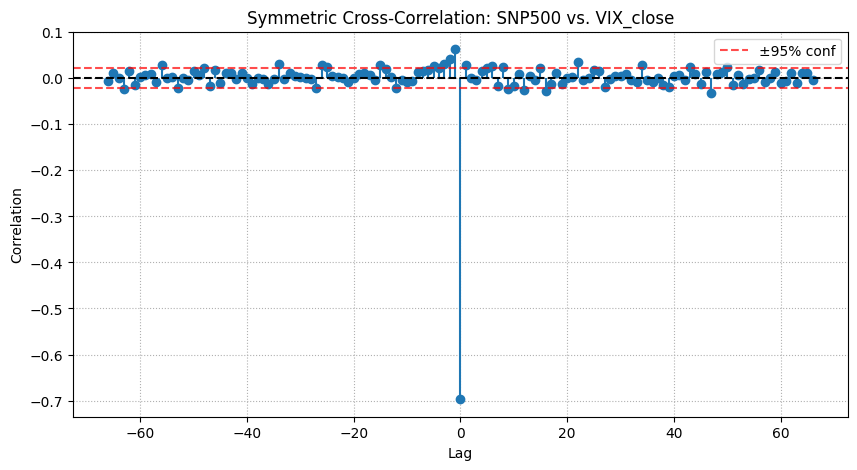

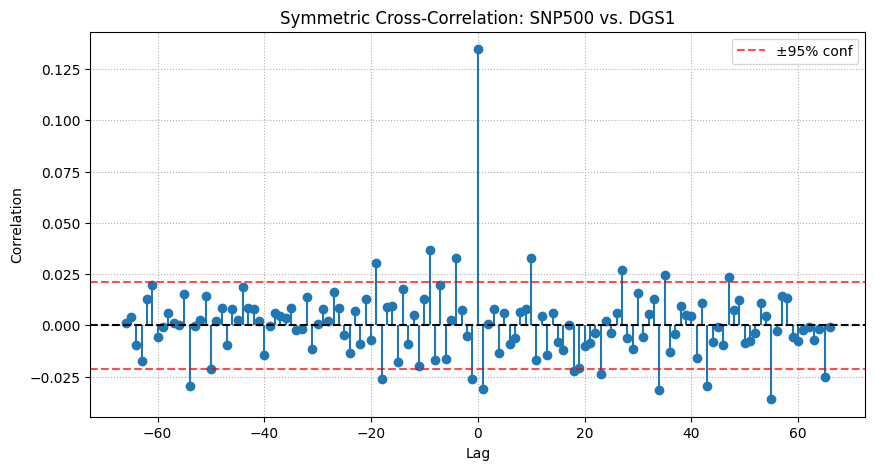

In [17]:
plot_ccf_symmetric_statsmodels(macro_joined["SNP500_close_growth1"].to_pandas(), macro_joined["VIX_close_growth1"].to_pandas(), max_lag=66, x_name="SNP500", y_name="VIX_close")
plot_ccf_symmetric_statsmodels(macro_joined["SNP500_close_growth1"].to_pandas(), macro_joined["dgs1_growth1"].to_pandas(), max_lag=66, x_name="SNP500", y_name="DGS1")

The cross-correlation plot suggests that,
- between SNP500 and VIX there is no clear cross-correlation, just a very negative correlation at lag 0.
- beteen SNP500 and DGS1 there is no clear direction in cross-correlation value, although if to exist, DGS1 might lead SNP500.

In [18]:
macro_joined = dgs_1.join(vix, on="datetime", how="inner")\
                .join(gold, on="datetime", how="inner") \
                .join(snp500, on="datetime", how="inner") \
                .filter(pl.col("datetime") > datetime(2000, 1, 1)).fill_null(strategy="forward").drop_nulls()

In [19]:
fig = make_subplots(
    rows=3, 
    cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.02, 
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{}]]  # Define una lista con dos filas
)


fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["VIX_close"], name='VIX Volatility'), row=1, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["dgs1"], name='Deposit Guarantee Schemes - 1 Year'), row=1, col=1, secondary_y=True)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["GOLD_close"], name='GOLD'), row=2, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["SNP500_close"], name='SNP500_close'), row=2, col=1, secondary_y=True)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["GOLD_volume"], name='GOLD volume'), row=3, col=1, secondary_y=False)



# Add a date filter selector
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
        type="date"
    )
)

# Update layout for better visualization
fig.update_layout(height=900, title_text=f"close Time Series with Lags", showlegend=True)

# Show the figure
fig.show()

What we can see here is that GOLD seems to get more attention right around times of high volatility, showing some kind of cross-correlation with VIX and therefore with the SNP500, with which there is an interesting interplay. It seems that if both GOLD starts to rise and DGS to fall, a downfall in SNP500 tends to follow. Judging from the cross-correlations below, it seems that the 30day growth in gold tends to lead a decrease in the 30d growth rate in SNP500.

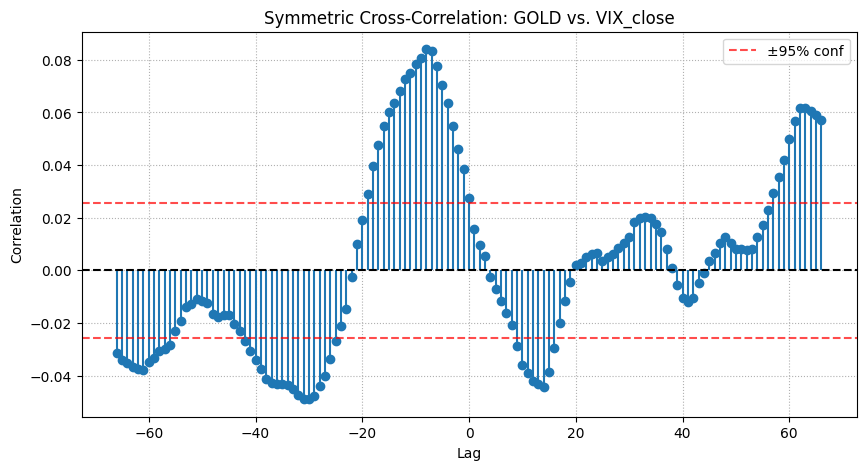

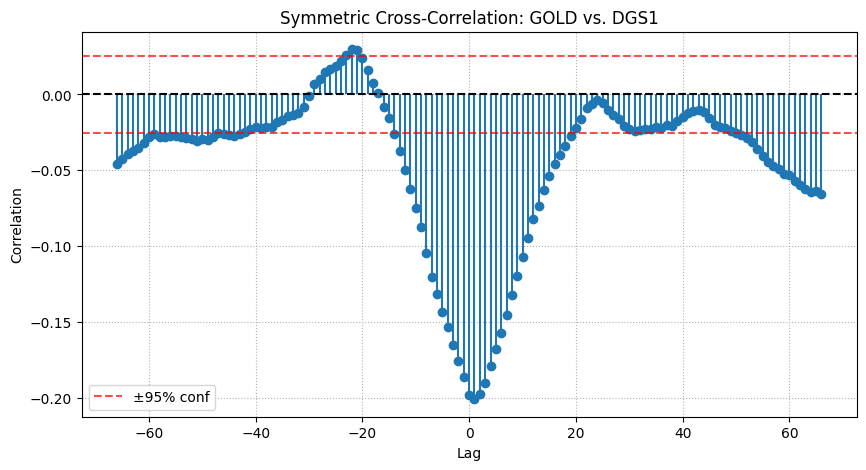

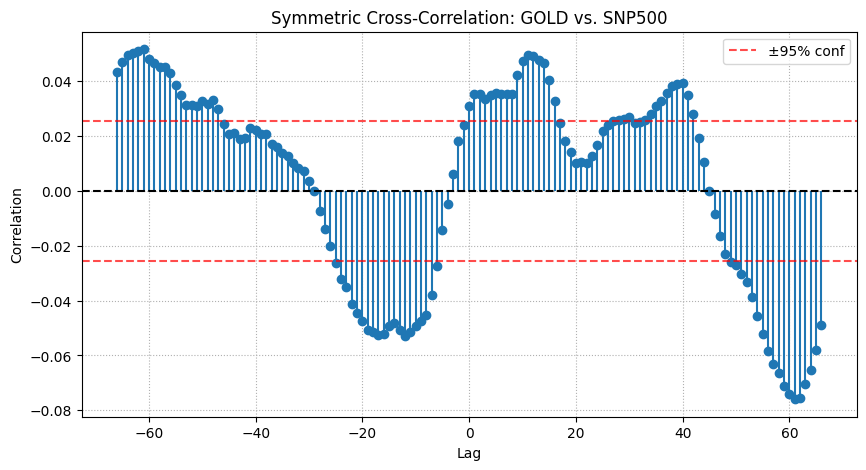

In [20]:
plot_ccf_symmetric_statsmodels(macro_joined["GOLD_close_growth30"].to_pandas(), macro_joined["VIX_close_growth30"].to_pandas(), max_lag=66, x_name="GOLD", y_name="VIX_close")
plot_ccf_symmetric_statsmodels(macro_joined["GOLD_close_growth30"].to_pandas(), macro_joined["dgs1_growth30"].to_pandas(), max_lag=66, x_name="GOLD", y_name="DGS1")
plot_ccf_symmetric_statsmodels(macro_joined["GOLD_close_growth30"].to_pandas(), macro_joined["SNP500_close_growth30"].to_pandas(), max_lag=66, x_name="GOLD", y_name="SNP500")

Inspecting their rolling correlation:

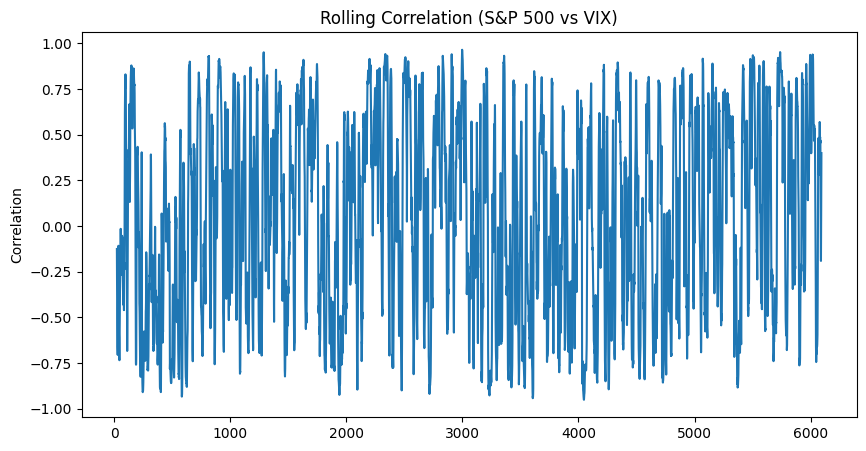

In [21]:
# Calculate rolling correlation
window = 22  # Rolling window size in time steps
rolling_corr = macro_joined['GOLD_close'].to_pandas().rolling(window).corr(macro_joined['SNP500_close'].to_pandas())

# Plot rolling correlation
rolling_corr.plot(title='Rolling Correlation (S&P 500 vs VIX)', figsize=(10, 5))
plt.ylabel('Correlation')
plt.show()

## Europe equivalent

In [22]:
ticker_extender = TickerExtender()

In [23]:
euro_yld = pl.read_csv("../data/extracted/macro/eurostat_euro_yield.csv")
euro_yld_1y = ticker_extender.transform_euro_yield_df(euro_yld).rename({"eur_yld_Y1_prev_2d":"eur_yld_y1"}).select(["datetime","eur_yld_y1"])
euro_yld_1y = euro_yld_1y.with_columns(pl.col("eur_yld_y1").pct_change(1).alias("eur_yld_growth1"))\
                                                    .with_columns(pl.col("eur_yld_y1").pct_change(22).alias("eur_yld_growth30"))
euro_yld_1y

datetime,eur_yld_y1,eur_yld_growth1,eur_yld_growth30
datetime[μs],f32,f32,f32
2004-09-08 00:00:00,2.29884,null,null
2004-09-09 00:00:00,2.32889,0.013072,null
2004-09-10 00:00:00,2.34667,0.007634,null
2004-09-13 00:00:00,2.30899,-0.016057,null
2004-09-14 00:00:00,2.27157,-0.016206,null
…,…,…,…
2025-01-16 00:00:00,2.37854,-0.000248,0.07167
2025-01-17 00:00:00,2.33828,-0.016926,0.054766
2025-01-20 00:00:00,2.3636,0.010828,0.072745


In [24]:
vstoxx = pl.read_csv("../data/extracted/macro/vstox.csv", separator=";").rename({"Date":"datetime","Indexvalue":"VSTOXX_close"}).select(pl.col("datetime").str.to_datetime(),
                                                                                                                         "VSTOXX_close")\
                                                        .with_columns(pl.col("VSTOXX_close").pct_change(1).alias("VSTOXX_growth1"))\
                                                        .with_columns(pl.col("VSTOXX_close").pct_change(22).alias("VSTOXX_growth30"))

euronext = pl.from_pandas(yf.download("^N100")["Close"],include_index=True).rename({"Date":"datetime","^N100":"EURONEXT_close"})\
                                                        .with_columns(pl.col("EURONEXT_close").pct_change(1).alias("EURONEXT_growth1"),
                                                                      pl.col("datetime").cast(pl.Datetime("us")))\
                                                        .with_columns(pl.col("EURONEXT_close").pct_change(22).alias("EURONEXT_growth30"))


macro_joined = euro_yld_1y.join(vix, on="datetime", how="inner")\
                .join(snp500, on="datetime", how="inner") \
                .join(vstoxx, on="datetime", how="inner") \
                .join(euronext, on="datetime", how="inner") \
                .join(dgs_1, on="datetime", how="inner")\
                .filter(pl.col("datetime") > datetime(1990, 1, 1)).fill_null(strategy="forward").drop_nulls()
macro_joined

[*********************100%***********************]  1 of 1 completed


datetime,eur_yld_y1,eur_yld_growth1,eur_yld_growth30,VIX_close,VIX_close_growth1,VIX_close_growth30,SNP500_close,SNP500_volume,SNP500_close_growth1,SNP500_close_growth30,VSTOXX_close,VSTOXX_growth1,VSTOXX_growth30,EURONEXT_close,EURONEXT_growth1,EURONEXT_growth30,dgs1,dgs1_growth1,dgs1_growth30
datetime[μs],f32,f32,f32,f64,f64,f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2004-10-08 00:00:00,2.27948,-0.000333,-0.008422,15.05,0.037931,0.070412,1122.140015,1291600000,-0.007527,0.005259,17.1179,0.02219,0.053896,640.179993,-0.004927,0.016901,2.21,-0.022124,0.057416
2004-10-11 00:00:00,2.27764,-0.000807,-0.022006,14.71,-0.022591,0.049964,1124.390015,943800000,0.002005,0.005374,16.6859,-0.025237,0.004382,638.659973,-0.002374,0.021104,2.21,0.0,0.057416
2004-10-12 00:00:00,2.22729,-0.022106,-0.050872,15.05,0.023114,0.09375,1121.839966,1320100000,-0.002268,-0.001851,17.4773,0.047429,0.06955,631.98999,-0.010444,0.00437,2.2,-0.004525,0.057692
2004-10-13 00:00:00,2.23158,0.001926,-0.033525,15.42,0.024585,0.170843,1113.650024,1546200000,-0.0073,-0.01081,17.639,0.009252,0.080841,633.330017,0.00212,-0.00548,2.17,-0.013636,0.033333
2004-10-14 00:00:00,2.20787,-0.010625,-0.028042,16.43,0.065499,0.211652,1103.290039,1489500000,-0.009303,-0.022192,17.8157,0.010018,0.105542,629.299988,-0.006363,-0.008805,2.15,-0.009217,0.033654
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
2025-01-15 00:00:00,2.37913,0.007491,0.098626,16.120001,-0.138429,0.18704,5949.910156,4544570000,0.018313,-0.02207,16.1034,-0.090414,0.097298,1489.719971,0.010089,0.015176,4.19,-0.007109,-0.011792
2025-01-16 00:00:00,2.37854,-0.000248,0.07167,16.6,0.029777,0.192529,5937.339844,4285810000,-0.002113,-0.018824,15.5624,-0.033595,0.025427,1505.859985,0.010834,0.026287,4.18,-0.002387,-0.016471
2025-01-17 00:00:00,2.33828,-0.016926,0.054766,15.97,-0.037952,0.156408,5996.660156,4366830000,0.009991,-0.008995,15.7161,0.009876,0.11693,1518.060059,0.008102,0.034756,4.21,0.007177,-0.02093


In [25]:
fig = make_subplots(
    rows=3, 
    cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.02, 
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Define una lista con dos filas
)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["VIX_close"], name='VIX Volatility'), row=1, col=1, secondary_y=False) 
fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["VSTOXX_close"], name='VSTOXX Volatility'), row=1, col=1, secondary_y=False)



fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["SNP500_close"], name='SNP500'), row=2, col=1, secondary_y=False)
fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["EURONEXT_close"], name='EURONEXT'), row=2, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["eur_yld_y1"], name='Euro Yield - 1 Year'), row=3, col=1, secondary_y=False)
fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["dgs1"], name='DGS - 1 Year'), row=3, col=1, secondary_y=False)



# Add a date filter selector
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
        type="date"
    )
)

# Update layout for better visualization
fig.update_layout(height=900, title_text=f"close Time Series with Lags", showlegend=True)

# Show the figure
fig.show()

We can see from the charts above that trading on the US market tends to be more profitable: There are higher returns and volatility is way less pronounced. Both indices were very close up until 2010, were the SNP500 skyrockets compared to the US index.

Both treasury bonds are also quite correlated and follow similar shapes, although we can observe that the US DGS1 is now higher than Europe's Euro Yield. The Euro Yield has even been negative up until very recently, indicating that investors in European assets found interest in securing their money rather than seeing returns.

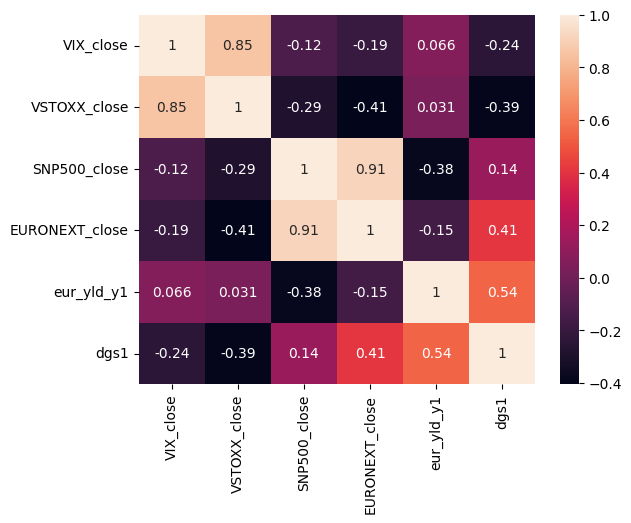

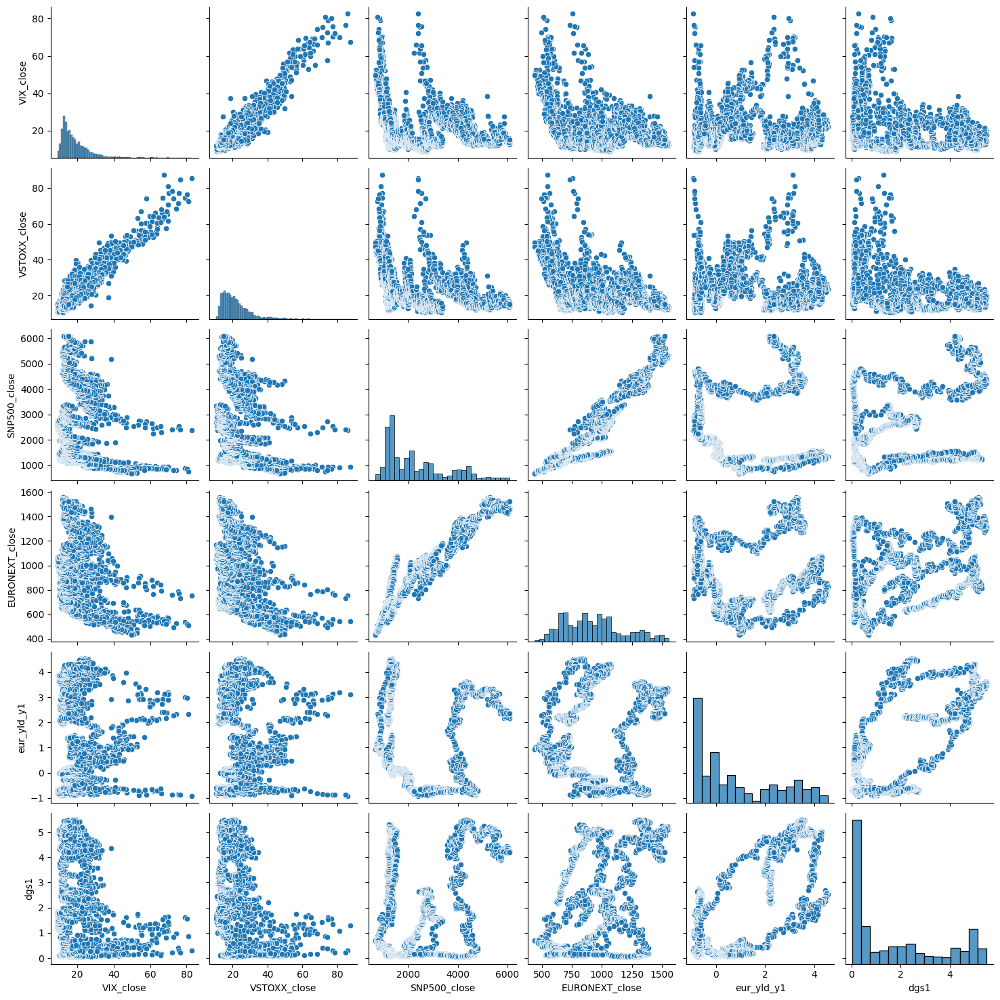

In [26]:
sns.heatmap(macro_joined["VIX_close","VSTOXX_close","SNP500_close","EURONEXT_close","eur_yld_y1","dgs1"].to_pandas().corr(numeric_only=True, method='spearman'), annot=True);

sns.pairplot(data=macro_joined["VIX_close","VSTOXX_close","SNP500_close","EURONEXT_close","eur_yld_y1","dgs1"].to_pandas());

## GDPPOT

In [27]:
pl.read_csv("../data/extracted/macro/FEDFUNDS.csv").rename({"date":"datetime"}).select(pl.col("datetime").str.to_datetime(), "fedfunds_prev1_mo")

datetime,fedfunds_prev1_mo
datetime[μs],f64
1955-02-01 00:00:00,1.39
1955-03-01 00:00:00,1.29
1955-04-01 00:00:00,1.35
1955-05-01 00:00:00,1.43
1955-06-01 00:00:00,1.43
…,…
2024-09-01 00:00:00,5.33
2024-10-01 00:00:00,5.13
2024-11-01 00:00:00,4.83


In [28]:
macro_joined

datetime,eur_yld_y1,eur_yld_growth1,eur_yld_growth30,VIX_close,VIX_close_growth1,VIX_close_growth30,SNP500_close,SNP500_volume,SNP500_close_growth1,SNP500_close_growth30,VSTOXX_close,VSTOXX_growth1,VSTOXX_growth30,EURONEXT_close,EURONEXT_growth1,EURONEXT_growth30,dgs1,dgs1_growth1,dgs1_growth30
datetime[μs],f32,f32,f32,f64,f64,f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2004-10-08 00:00:00,2.27948,-0.000333,-0.008422,15.05,0.037931,0.070412,1122.140015,1291600000,-0.007527,0.005259,17.1179,0.02219,0.053896,640.179993,-0.004927,0.016901,2.21,-0.022124,0.057416
2004-10-11 00:00:00,2.27764,-0.000807,-0.022006,14.71,-0.022591,0.049964,1124.390015,943800000,0.002005,0.005374,16.6859,-0.025237,0.004382,638.659973,-0.002374,0.021104,2.21,0.0,0.057416
2004-10-12 00:00:00,2.22729,-0.022106,-0.050872,15.05,0.023114,0.09375,1121.839966,1320100000,-0.002268,-0.001851,17.4773,0.047429,0.06955,631.98999,-0.010444,0.00437,2.2,-0.004525,0.057692
2004-10-13 00:00:00,2.23158,0.001926,-0.033525,15.42,0.024585,0.170843,1113.650024,1546200000,-0.0073,-0.01081,17.639,0.009252,0.080841,633.330017,0.00212,-0.00548,2.17,-0.013636,0.033333
2004-10-14 00:00:00,2.20787,-0.010625,-0.028042,16.43,0.065499,0.211652,1103.290039,1489500000,-0.009303,-0.022192,17.8157,0.010018,0.105542,629.299988,-0.006363,-0.008805,2.15,-0.009217,0.033654
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
2025-01-15 00:00:00,2.37913,0.007491,0.098626,16.120001,-0.138429,0.18704,5949.910156,4544570000,0.018313,-0.02207,16.1034,-0.090414,0.097298,1489.719971,0.010089,0.015176,4.19,-0.007109,-0.011792
2025-01-16 00:00:00,2.37854,-0.000248,0.07167,16.6,0.029777,0.192529,5937.339844,4285810000,-0.002113,-0.018824,15.5624,-0.033595,0.025427,1505.859985,0.010834,0.026287,4.18,-0.002387,-0.016471
2025-01-17 00:00:00,2.33828,-0.016926,0.054766,15.97,-0.037952,0.156408,5996.660156,4366830000,0.009991,-0.008995,15.7161,0.009876,0.11693,1518.060059,0.008102,0.034756,4.21,0.007177,-0.02093


In [54]:
gdppot = pl.read_csv("../data/extracted/macro/GDPPOT.csv").rename({"date":"datetime"}).with_columns(pl.col("datetime").str.to_datetime())\
                                                        .with_columns(pl.col("gdppot").pct_change(1).alias("gdppot_growth1"))\
                                                        .with_columns(pl.col("gdppot").pct_change(22).alias("gdppot_growth30"))

fedfunds = pl.read_csv("../data/extracted/macro/FEDFUNDS.csv").rename({"date":"datetime"})\
                                                    .select(pl.col("datetime").str.to_datetime(), "fedfunds_prev1_mo")\
                                                    .with_columns(pl.col("fedfunds_prev1_mo").pct_change(1).alias("fedfunds_prev1_mo_growth1"))\
                                                    .with_columns(pl.col("fedfunds_prev1_mo").pct_change(22).alias("fedfunds_prev1_mo_growth30"))

macro_joined2 = snp500.join(vix, on="datetime", how="inner")\
                .join(dgs_1, on="datetime", how="inner")\
                .join(fedfunds, on="datetime", how="full") 
                            #.join(gdppot, on="datetime", how="inner")

In [57]:
macro_joined2 = macro_joined2.with_columns(pl.col("datetime_right").fill_null(macro_joined2["datetime"]).alias("datetime")).sort(by="datetime").filter(pl.col("datetime") > datetime(1990,1,1)).fill_null(strategy="forward")

In [60]:
fig = make_subplots(
    rows=3, 
    cols=1, 
    shared_xaxes=True, 
    vertical_spacing=0.02, 
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Define una lista con dos filas
)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["VIX_close"], name='VIX'), row=1, col=1, secondary_y=True) 
fig.add_trace(go.Line(x=macro_joined2["datetime"], y=macro_joined2["fedfunds_prev1_mo"], name='fedfunds_prev1_mo'), row=1, col=1, secondary_y=False) 

fig.add_trace(go.Scatter(x=macro_joined2["datetime"], y=macro_joined2["SNP500_close"], name='SNP500'), row=2, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined2["datetime"], y=macro_joined2["dgs1"], name='DGS - 1 Year'), row=3, col=1, secondary_y=False)



# Add a date filter selector
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
        type="date"
    )
)

# Update layout for better visualization
fig.update_layout(height=900, title_text=f"close Time Series with Lags", showlegend=True)

# Show the figure
fig.show()

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




Tu pregunta involucra múltiples variables macroeconómicas y activos financieros interrelacionados, lo cual es muy interesante. Vamos por partes:

---

### **FEDFUNDS y Volatilidad:**
- **Tasas FED (FEDFUNDS):** 
  - **Subidas de tasas:** Cuando la Reserva Federal sube las tasas, tiende a enfriar la economía, lo que reduce la inflación pero puede aumentar la volatilidad si los mercados anticipan un impacto negativo en el crecimiento (afectando al S&P500).
  - **Bajas de tasas:** Una política monetaria expansiva reduce la volatilidad, dado que fomenta la liquidez y el crecimiento económico.

---

### **GDPPOT (Potencial del PIB):**
- **Relación con la volatilidad:**
  - Si el PIB real está por debajo del PIB potencial (**GDPPOT**), esto puede generar aversión al riesgo en los mercados, aumentando la volatilidad. Esto ocurre porque el crecimiento económico insuficiente sugiere problemas estructurales o incertidumbre.

- **Impacto en activos financieros:**
  - **Bonos:** Si el crecimiento está por debajo del GDPPOT, los inversores tienden a buscar refugio en bonos, bajando sus rendimientos.
  - **Oro:** Un menor crecimiento económico puede aumentar el atractivo del oro como refugio.
  - **S&P500:** Una brecha negativa entre el PIB real y el GDPPOT suele presionar a la baja a los índices de acciones debido a menores expectativas de crecimiento.
  - **Bitcoin:** En períodos de incertidumbre económica, BTC puede actuar como un activo alternativo, aunque su volatilidad es mucho mayor que la del oro.

---

### **Interplay entre Bonds, Gold, S&P500 y BTC:**
1. **Bonds y Gold:**
   - Cuando hay incertidumbre económica o alta volatilidad, los inversores buscan refugio en bonos (disminuyendo sus rendimientos) y oro (aumentando su precio). Ambos suelen estar correlacionados inversamente con activos de riesgo como el S&P500.

2. **Bonds y S&P500:**
   - **Rendimientos altos:** Impactan negativamente al S&P500 porque elevan los costos de financiamiento.
   - **Rendimientos bajos:** Benefician al mercado accionario, especialmente sectores sensibles a tasas como bienes raíces y tecnología.

3. **Gold y BTC:**
   - Oro y BTC suelen competir como refugios alternativos. En entornos de alta inflación o desconfianza en los sistemas financieros tradicionales, ambos pueden beneficiarse, pero BTC es más volátil.

4. **S&P500 y BTC:**
   - En mercados alcistas, BTC puede moverse en tándem con el S&P500, reflejando apetito por activos de riesgo. Sin embargo, en momentos de pánico, BTC tiende a correlacionarse negativamente debido a su alta volatilidad.

---

### **Relaciones generales durante alta volatilidad:**
| **Activo**   | **Reacción esperada**                                      |
|--------------|------------------------------------------------------------|
| **FEDFUNDS** | Subida de tasas: aumenta la volatilidad, reduce S&P500.    |
| **GDPPOT**   | Brecha negativa: favorece refugios (bonos, oro, BTC).      |
| **Bonds**    | Rendimientos bajos: oro sube, S&P500 puede recuperar.      |
| **Gold**     | Subida en alta incertidumbre (baja confianza en mercados). |
| **S&P500**   | Baja si la volatilidad (VIX) aumenta o las tasas suben.    |
| **BTC**      | Alta correlación con riesgo, pero refugio en crisis macro. |

---

¿Quieres un análisis más detallado de alguno de estos factores o ejemplos históricos que respalden estas relaciones?

## GDPPOT

## BTC

Para utilizar estos indicadores en la selección de acciones individuales, considera:

1. **Sectores defensivos:** En períodos de alta volatilidad, empresas en sectores como consumo básico, salud, y utilities suelen ser más estables.

2. **Empresas con alta correlación con commodities:** Si un commodity específico está subiendo (como el oro), las empresas mineras o relacionadas con ese commodity pueden beneficiarse.

3. **Empresas de calidad:** En entornos de alta volatilidad, empresas con balances sólidos y buenos flujos de caja suelen ser más atractivas.

4. **Sentimiento del mercado:** Usa el VIX como un barómetro general. Cuando baja, puede ser un buen momento para considerar acciones más riesgosas o de crecimiento.


Me da la impresión de que la conclusión es: Hay correlaciones, parece que hay ciclos entre volatilidad, GOLD, stocks, DGS, etc, pero quien empieza el movimiento parece cambiar.

## Macroeconomics - countries interplay

- No sé muy bien qué hacer. Algo con la moneda y tal pero de momento: Meter en un backlog o un next steps. O muy al final en sección someday del backlog.

Macroeconomic indicators by country
- DGS (US) and EuroYield. When bonds do better than stocks, it is a sign of fear in the stock market, just like with GOLD. A better indicator is the safe haven demand. TLT, GLD
- Stock price strength
- VIX (US) + 50 day SMA. High values mean high fear
- CPI

Indices by country
- SNP500
- DAX (Germany)
- EURONEXT


Indices by sector
- FNGU..

Global indicators
- WTI
- Brent Oil
- Gold
- BTC
- How do I tell cycles?

If GOLD and Bonds, or other commodities do well, it is a sign of fear.

In [305]:
# Example usage
mi_matrix, joint_entropy_matrix = compute_normalized_mi_with_regression(
    dataset=macro_joined.select(pl.exclude("datetime"))
)


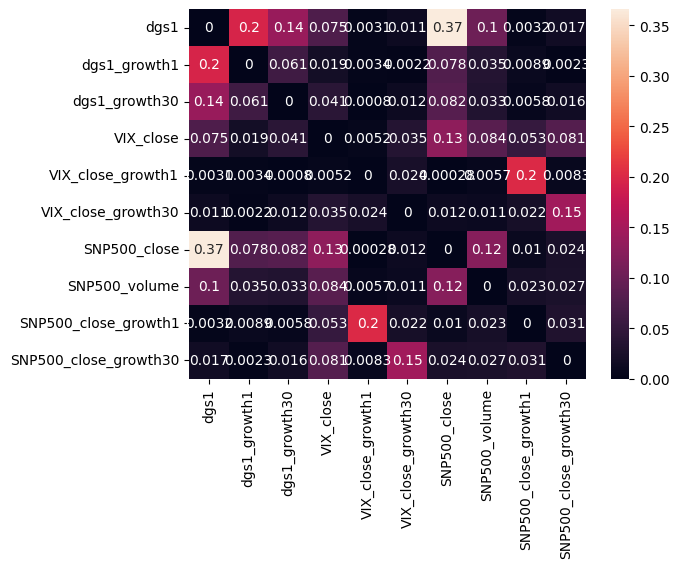

In [307]:
sns.heatmap(mi_matrix,annot=True);

In [ ]:
CPI

In [27]:

dgs_1

DATE,DGS1_prev1_d
str,f64
"""1962-01-03T00:00:00.000000000""",3.22
"""1962-01-04T00:00:00.000000000""",3.24
"""1962-01-05T00:00:00.000000000""",3.24
"""1962-01-06T00:00:00.000000000""",3.26
"""1962-01-09T00:00:00.000000000""",3.31
…,…
"""2025-01-18T00:00:00.000000000""",4.21
"""2025-01-21T00:00:00.000000000""",null
"""2025-01-22T00:00:00.000000000""",4.21


In [28]:
VIX = pl.read_csv("../data/extracted/macro/^VIX.csv")
VIX

date,close,high,low,open,volume,symbol,currency,country,region
str,f64,f64,f64,f64,i64,str,str,str,str
"""1990-01-02T00:00:00.000000000""",17.24,17.24,17.24,17.24,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-03T00:00:00.000000000""",18.190001,18.190001,18.190001,18.190001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-04T00:00:00.000000000""",19.219999,19.219999,19.219999,19.219999,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-05T00:00:00.000000000""",20.110001,20.110001,20.110001,20.110001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-08T00:00:00.000000000""",20.26,20.26,20.26,20.26,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
…,…,…,…,…,…,…,…,…,…
"""2025-01-17T00:00:00.000000000""",15.97,16.23,15.53,16.190001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""2025-01-21T00:00:00.000000000""",15.06,16.290001,14.93,16.290001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""2025-01-22T00:00:00.000000000""",15.1,15.29,14.59,14.89,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""


In [12]:
ticker_extender = TickerExtender()
euro_yld = pl.read_csv("../data/extracted/macro/eurostat_euro_yield.csv")
euro_yld = ticker_extender.transform_euro_yield_df(euro_yld)
euro_yld


datetime,eur_yld_DGS_Y1_prev_2d,eur_yld_DGS_Y5_prev_2d,eur_yld_DGS_Y10_prev_2d
datetime[μs],f32,f32,f32
2004-09-08 00:00:00,2.29884,3.45722,4.20922
2004-09-09 00:00:00,2.32889,3.47952,4.20963
2004-09-10 00:00:00,2.34667,3.50789,4.22842
2004-09-13 00:00:00,2.30899,3.43063,4.16187
2004-09-14 00:00:00,2.27157,3.37473,4.12098
…,…,…,…
2025-01-16 00:00:00,2.37854,2.39536,2.71869
2025-01-17 00:00:00,2.33828,2.30341,2.63028
2025-01-20 00:00:00,2.3636,2.31758,2.65778


In [286]:
import pandas_datareader as pdr

umcsent = pdr.DataReader("UMCSENT", "fred", start="2000-01-01")


,UMCSENT
DATE,
2000-01-01,112.0
2000-02-01,111.3
2000-03-01,107.1
2000-04-01,109.2
2000-05-01,110.7
...,...
2024-08-01,67.9
2024-09-01,70.1
2024-10-01,70.5


In [290]:
umcsent.iloc[-50:-30,]

,UMCSENT
DATE,
2020-11-01,76.9
2020-12-01,80.7
2021-01-01,79.0
2021-02-01,76.8
2021-03-01,84.9
2021-04-01,88.3
2021-05-01,82.9
2021-06-01,85.5
2021-07-01,81.2


<Axes: xlabel='DATE'>

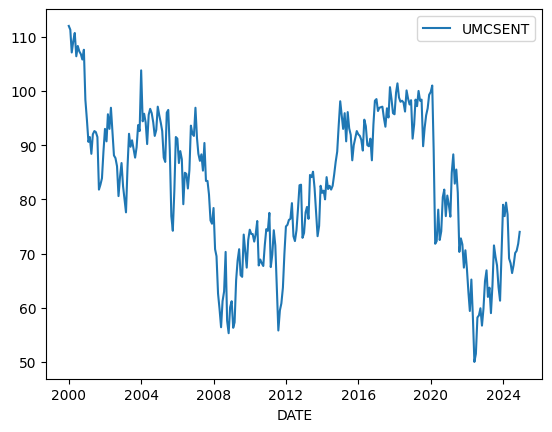

In [490]:
sns.lineplot(umcsent)

## Principles of economic factors

# Analysis between stocks

- Macro indicators with SNP500 and other indices
- Add currencies

## Correlation analysis 

<Axes: >

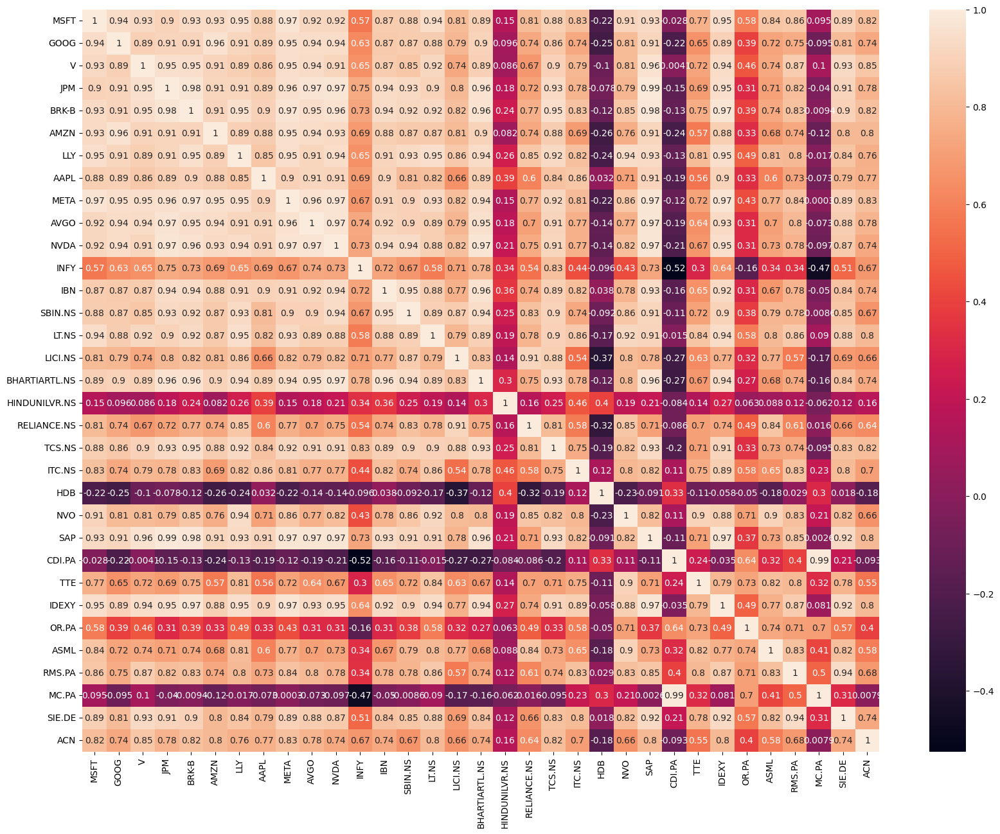

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,15))
sns.heatmap(joined_symbol.select(pl.exclude("datetime")).to_pandas().corr(), annot=True)

<Axes: >

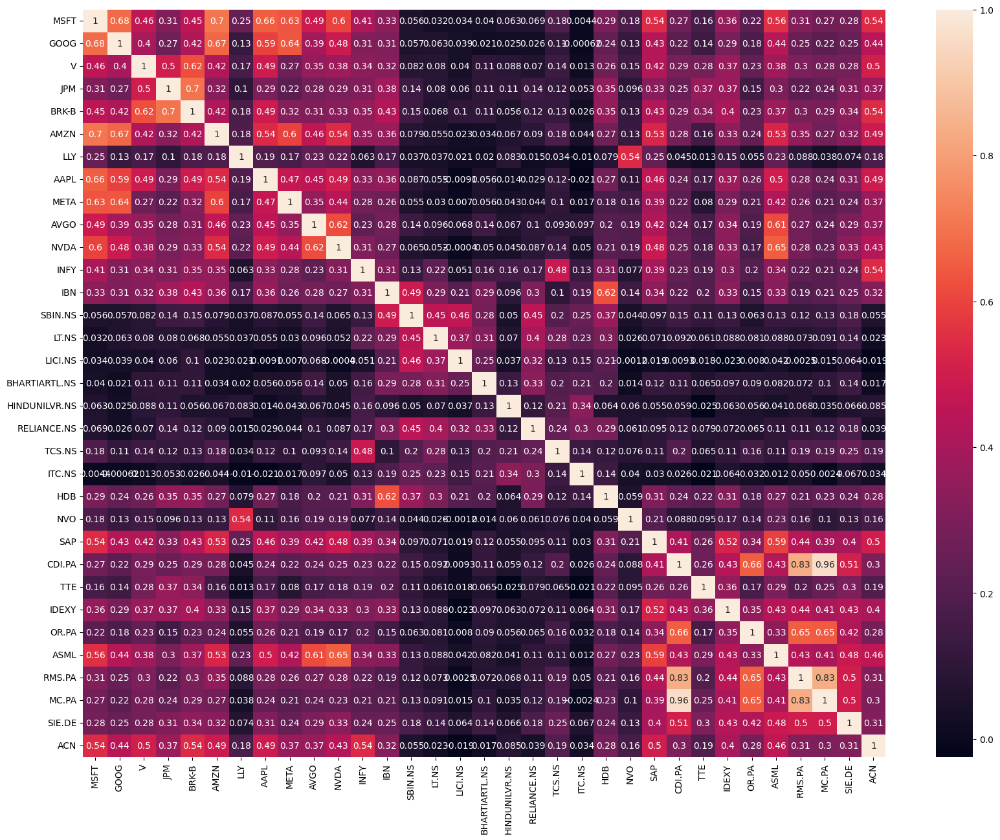

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,15))
sns.heatmap(joined_symbol_lagged.drop_nulls().to_pandas().corr(), annot=True)

Heatmap of:
- Original ["close"]
- Growth over 1d
- Growth over 7d
- Growth over 30d (?)

Pairplot:
- Original
- Growth over 1d

Add mutual information heatmap if it applies, to contrast with pairplot

<Axes: xlabel='MSFT', ylabel='GOOG'>

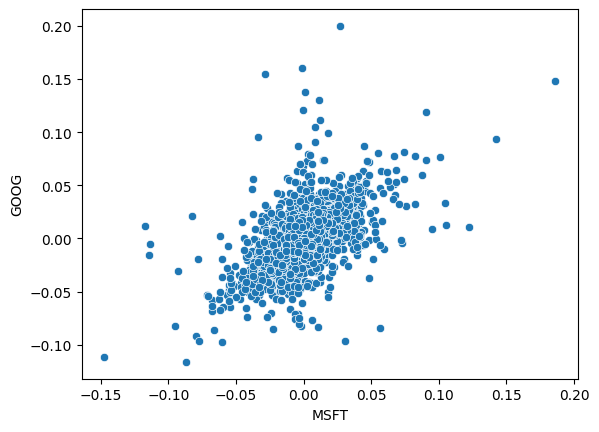

In [351]:
sns.scatterplot(data=joined_symbol_lagged,
                x="MSFT",
                y= "GOOG")

## Cross-correlation

In [374]:
def multi_xcorr_lag(data):
    results = {}
    for (col1, col2) in combinations(data.columns, 2):
        corr = correlate(data[col1], data[col2], mode='full')
        lags = correlation_lags(len(data[col1]), len(data[col2]), mode='full')
        optimal_lag = lags[np.argmax(corr)]
        results[f"{col1} vs {col2}"] = optimal_lag
    return results

## Plot time series comparison

Plot time series diff

<Axes: >

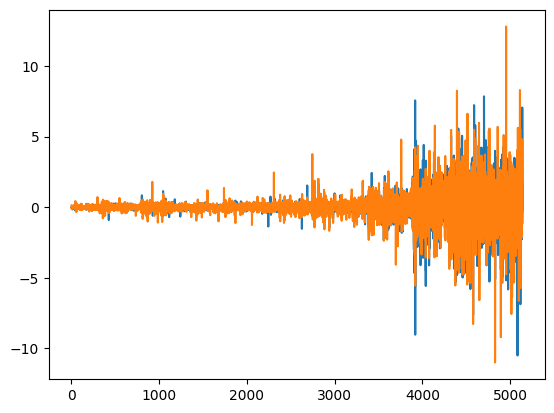

In [301]:
joined_symbol_diffed_norm = joined_symbol_diffed.with_columns(
                ((pl.exclude("datetime") - pl.exclude("datetime").mean()) / pl.exclude("datetime").std()
                 ))
sns.lineplot(joined_symbol_diffed_norm["MSFT"])
sns.lineplot(joined_symbol_diffed_norm["GOOG"])

Autocorrelación

<Figure size 1200x1000 with 0 Axes>

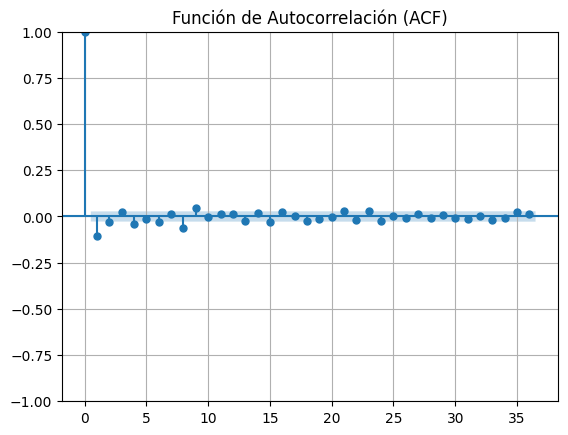

<Figure size 1200x1000 with 0 Axes>

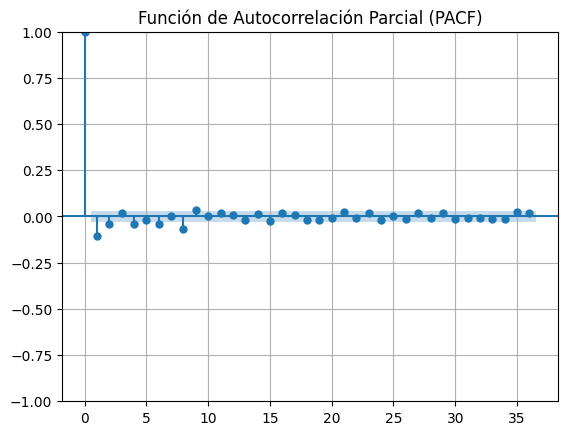

In [ ]:

plot_acf_pacf(data_test=joined_symbol_lagged["MSFT"])

### Cross-correlation

Usar ccf de statsmodels mejor, con el cálculo de la significación y la simetría generados:

[                       0%                       ]

[*********************100%***********************]  2 of 2 completed


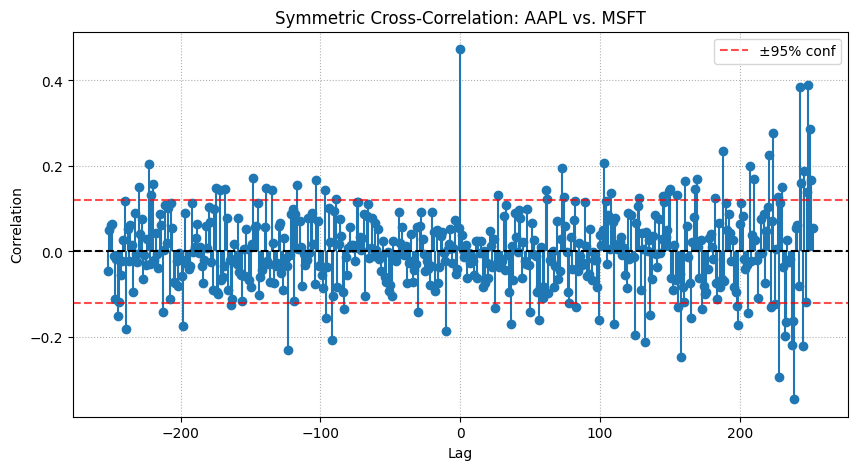

In [127]:
# Example usage:
from yfinance import download
df = download(["MSFT", "AAPL"], start="2023-12-01", end="2025-01-01")["Close"]
# Suppose we plot symmetrical CCF on daily returns
ret_aapl = df["MSFT"].pct_change().dropna()
ret_msft = df["AAPL"].pct_change().dropna()
plot_ccf_symmetric_statsmodels(ret_aapl, ret_msft, max_lag=252, x_name="AAPL", y_name="MSFT")